In [1]:
import matplotlib.pyplot as plt
import numpy as np
import pickle, os
import pandas as pd
from glob import glob

from utils import *

# Read in pickle files produced by segmentation_c_elegans_3d.py

In [62]:
pickfiles = glob("segmentation/*/*/*/*/*.pick")
print(len(pickfiles))

os.path.basename(pickfiles[0])

118


'JM259_3_L1_L4440_RNAi_9.pick'

### Retain only the process images and the spot dataframe

In [63]:
def filter_keys(selected_keys, obj):
    keys = obj.keys()
    for k in list(keys):
        if k not in selected_keys:
            del obj[k]
alldata = {}

for pick in pickfiles:
    key, obj, data = load_data(pick)
    filter_keys(['rotated_cropped_segmented_image','rotated_cropped_masked_GFP','dataframe'], obj)
    alldata.update(data)

keys = alldata.keys()
print("Total number read in:", len(keys))

reading pickle from JM259_3_L1_L4440_RNAi_9.pick... done
reading pickle from JM259_3_L1_L4440_RNAi_6.pick... done
reading pickle from JM259_3_L1_L4440_RNAi_3.pick... done
reading pickle from JM259_3_L1_L4440_RNAi_4.pick... done
reading pickle from JM259_3_L1_L4440_RNAi_5.pick... done
reading pickle from JM259_3_L1_L4440_RNAi_7.pick... done
reading pickle from JM259_3_L1_L4440_RNAi_2.pick... done
reading pickle from JM259_3_L1_L4440_RNAi_8.pick... done
reading pickle from JM259_3_L1_L4440_RNAi_1.pick... done
reading pickle from JM259_3_L1_L4440_RNAi_10.pick... done
reading pickle from JM259_3_L1_ELT-2_RNAi_8.pick... done
reading pickle from JM259_3_L1_ELT-2_9.pick... done
reading pickle from JM259_3_L1_ELT-2_RNAi_1.pick... done
reading pickle from JM259_3_L1_ELT-2_2.pick... done
reading pickle from JM259_3_L1_ELT-2_RNAi_5.pick... done
reading pickle from JM259_3_L1_ELT-2_RNAi_6.pick... done
reading pickle from JM259_3_L1_ELT-2_RNAi_3.pick... done
reading pickle from JM259_3_L1_ELT-2_RNA

### Divide the input by genotype/RNAi

In [64]:
# divide out into groups
JM149_L4440 = {}
JM149_ELT2 = {}
JM259_L4440 = {}
JM259_ELT2 = {}
for k in keys:
    genotype, rep, stage, rnai, wormnum = k
    if genotype == 'JM149':
        if rnai == 'L4440_RNAi':
            JM149_L4440[k] = alldata[k]
        elif rnai == 'ELT-2_RNAi':
            JM149_ELT2[k] = alldata[k]
        elif rnai == 'L4440':
            JM149_L4440[k] = alldata[k]
        elif rnai == 'ELT-2':
            JM149_ELT2[k] = alldata[k]
        else:
            print("unexpected RNAi:", k)
    elif genotype == 'JM259':
        if rnai == 'L4440_RNAi':
            JM259_L4440[k] = alldata[k]
        elif rnai == 'ELT-2_RNAi':
            JM259_ELT2[k] = alldata[k]
        elif rnai == 'L4440':
            JM259_L4440[k] = alldata[k]
        elif rnai == 'ELT-2':
            JM259_ELT2[k] = alldata[k]
        else:
            print("unexpected RNAi:", k)
    else:
        print("unexpected genotype:", k)
    

print(f"{len(JM149_L4440)=}")
print(f"{len(JM259_L4440)=}")
print(f"{len(JM149_ELT2)=}")
print(f"{len(JM259_ELT2)=}")
for key in JM149_ELT2.keys():
    print(key)

len(JM149_L4440)=29
len(JM259_L4440)=30
len(JM149_ELT2)=28
len(JM259_ELT2)=31
('JM149', '3', 'L1', 'ELT-2_RNAi', '5')
('JM149', '3', 'L1', 'ELT-2_RNAi', '2')
('JM149', '3', 'L1', 'ELT-2_RNAi', '7')
('JM149', '3', 'L1', 'ELT-2_RNAi', '10')
('JM149', '3', 'L1', 'ELT-2', '1')
('JM149', '3', 'L1', 'ELT-2', '6')
('JM149', '3', 'L1', 'ELT-2', '3')
('JM149', '3', 'L1', 'ELT-2', '9')
('JM149', '3', 'L1', 'ELT-2', '8')
('JM149', '3', 'L1', 'ELT-2_RNAi', '4')
('JM149', '1', 'L1', 'ELT-2', '5')
('JM149', '1', 'L1', 'ELT-2', '2')
('JM149', '1', 'L1', 'ELT-2', '7')
('JM149', '1', 'L1', 'ELT-2', '1')
('JM149', '1', 'L1', 'ELT-2_RNAi', '6')
('JM149', '1', 'L1', 'ELT-2', '3')
('JM149', '1', 'L1', 'ELT-2', '9')
('JM149', '1', 'L1', 'ELT-2_RNAi', '8')
('JM149', '1', 'L1', 'ELT-2', '4')
('JM149', '2', 'L1', 'ELT-2_RNAi', '5')
('JM149', '2', 'L1', 'ELT-2_RNAi', '2')
('JM149', '2', 'L1', 'ELT-2_RNAi', '10')
('JM149', '2', 'L1', 'ELT-2_RNAi', '7-8')
('JM149', '2', 'L1', 'ELT-2', '1')
('JM149', '2', 'L1', 'E

# Plot the groups

## JM259/ELT2 RNAi

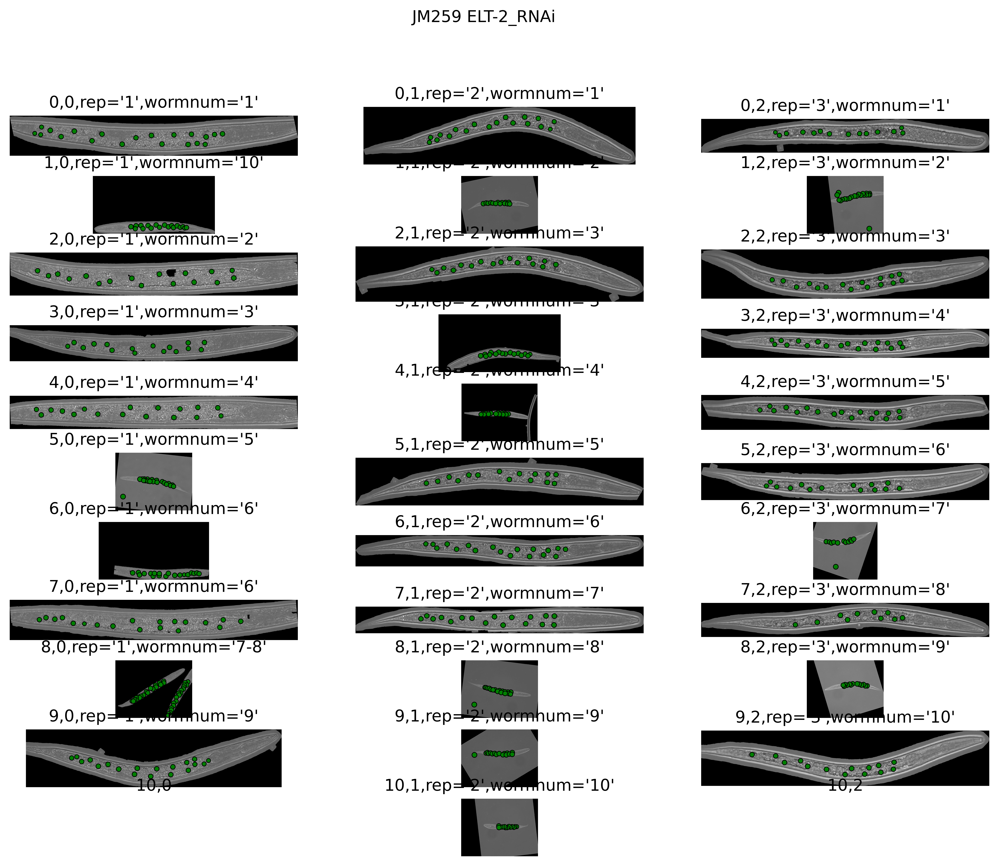

In [67]:
to_plot_rep_1 = []
to_plot_rep_2 = []
to_plot_rep_3 = []

for k,v in JM259_ELT2.items():
    genotype, rep, stage, RNAi, worm = k
    if rep == "1":  to_plot_rep_1.append((k,v))
    if rep == "2":  to_plot_rep_2.append((k,v))
    if rep == "3":  to_plot_rep_3.append((k,v))

maxplotlen = 0
for to_plot in to_plot_rep_1, to_plot_rep_2, to_plot_rep_3:
    maxplotlen = max(maxplotlen, len(to_plot))
    try:
        to_plot.sort(key=lambda k: int(k[0][4]))
    except:
        to_plot.sort(key=lambda k: k[0][4])

fig, ax = plt.subplots(maxplotlen,3,dpi = 600, figsize=(13,10))
#plt.subplots_adjust(left=.2, right=.5, top=.5, bottom=0)
genotype, rep, stage, RNAi, worm = to_plot_rep_1[0][0]
fig.suptitle(f"{genotype} {RNAi}")
brightfield_plot_styles={'s': 1.5, 'alpha':1, 'linewidths':.5, 'facecolors': 'g', 'edgecolors': 'black' }
gfp_plot_styles={'s': 1.5, 'alpha':.5, 'linewidths':.5, 'facecolors': 'none', 'edgecolors': 'r' }
color_map = 'Greys_r'
from itertools import zip_longest

skip = [] #[(0,6),(1,2)]

for i,wormset in enumerate(zip_longest(to_plot_rep_1, to_plot_rep_2, to_plot_rep_3)):
    for j,worm in enumerate(wormset):
        ax[i,j].axis('off') 
        ax[i,j].grid(False)
        
        if worm is None: 
            ax[i,j].set(title=f"{i},{j}")
            continue
         
        k,v = worm
        genotype, rep, stage, RNAi, wormnum = k 
        
        ax[i,j].set(title=f"{i},{j},{rep=},{wormnum=}")
        if (j,i) in skip: continue
            

        df_in_mask_rotated = v['dataframe'] 
        rotated_cropped_segmented_image = v['rotated_cropped_segmented_image'] 
        rotated_cropped_masked_GFP = v['rotated_cropped_masked_GFP']

        annotate_spots(df_in_mask_rotated, rotated_cropped_segmented_image, ax=ax[i,j], plot_styles=brightfield_plot_styles)
        #annotate_spots(df_in_mask_rotated, rotated_cropped_masked_GFP, ax=ax[i,j], plot_styles=gfp_plot_styles)

plt.show()


## Plot JM259 L4440

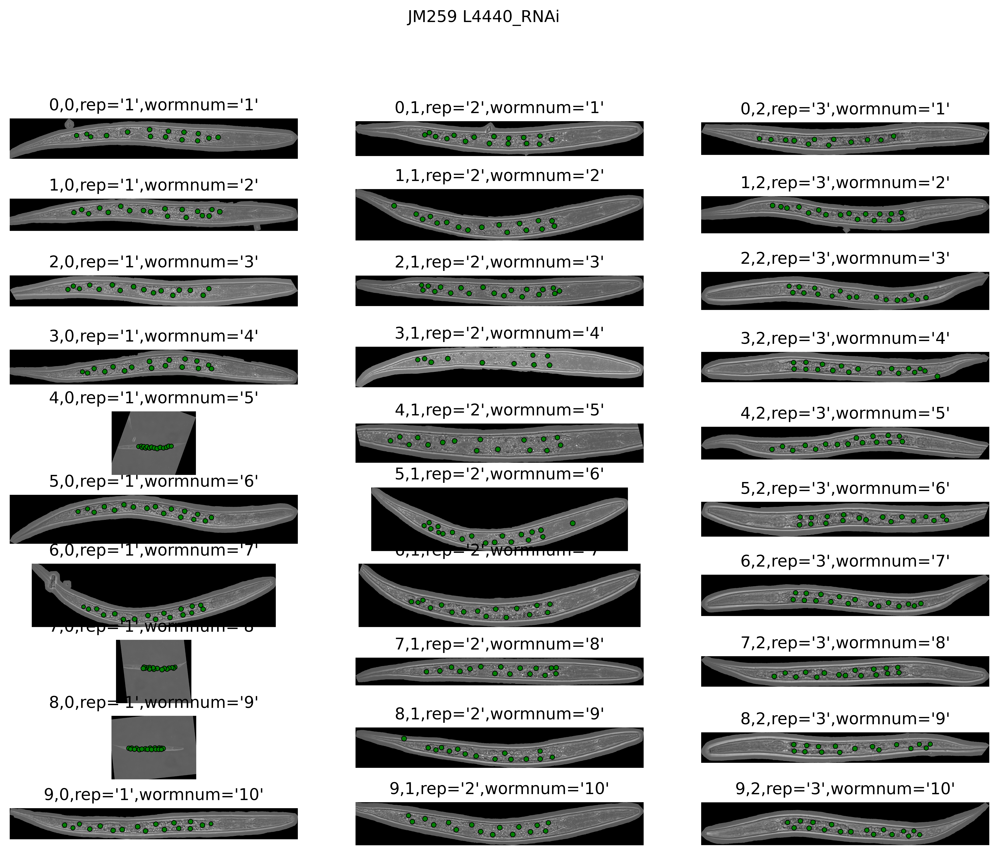

In [66]:
to_plot_rep_1 = []
to_plot_rep_2 = []
to_plot_rep_3 = []

for k,v in JM259_L4440.items():
    genotype, rep, stage, RNAi, worm = k
    if rep == "1":  to_plot_rep_1.append((k,v))
    if rep == "2":  to_plot_rep_2.append((k,v))
    if rep == "3":  to_plot_rep_3.append((k,v))

maxplotlen = 0
for to_plot in to_plot_rep_1, to_plot_rep_2, to_plot_rep_3:
    maxplotlen = max(maxplotlen, len(to_plot))
    try:
        to_plot.sort(key=lambda k: int(k[0][4]))
    except:
        to_plot.sort(key=lambda k: k[0][4])

fig, ax = plt.subplots(maxplotlen,3,dpi = 600, figsize=(13,10))
#plt.subplots_adjust(left=.2, right=.5, top=.5, bottom=0)
genotype, rep, stage, RNAi, worm = to_plot_rep_1[0][0]
fig.suptitle(f"{genotype} {RNAi}")
brightfield_plot_styles={'s': 1.5, 'alpha':1, 'linewidths':.5, 'facecolors': 'g', 'edgecolors': 'black' }
gfp_plot_styles={'s': 1.5, 'alpha':.5, 'linewidths':.5, 'facecolors': 'none', 'edgecolors': 'r' }
color_map = 'Greys_r'
from itertools import zip_longest

skip = []

for i,wormset in enumerate(zip_longest(to_plot_rep_1, to_plot_rep_2, to_plot_rep_3)):
    for j,worm in enumerate(wormset):
        ax[i,j].axis('off') 
        ax[i,j].grid(False)
        
        if worm is None: 
            ax[i,j].set(title=f"{i},{j}")
            continue
         
        k,v = worm
        genotype, rep, stage, RNAi, wormnum = k 
        
        ax[i,j].set(title=f"{i},{j},{rep=},{wormnum=}")
        if (j,i) in skip: continue
            

        df_in_mask_rotated = v['dataframe'] 
        rotated_cropped_segmented_image = v['rotated_cropped_segmented_image'] 
        rotated_cropped_masked_GFP = v['rotated_cropped_masked_GFP']

        annotate_spots(df_in_mask_rotated, rotated_cropped_segmented_image, ax=ax[i,j], plot_styles=brightfield_plot_styles)
        #annotate_spots(df_in_mask_rotated, rotated_cropped_masked_GFP, ax=ax[i,j], plot_styles=gfp_plot_styles)

plt.show()


## Plot JM149 L4440

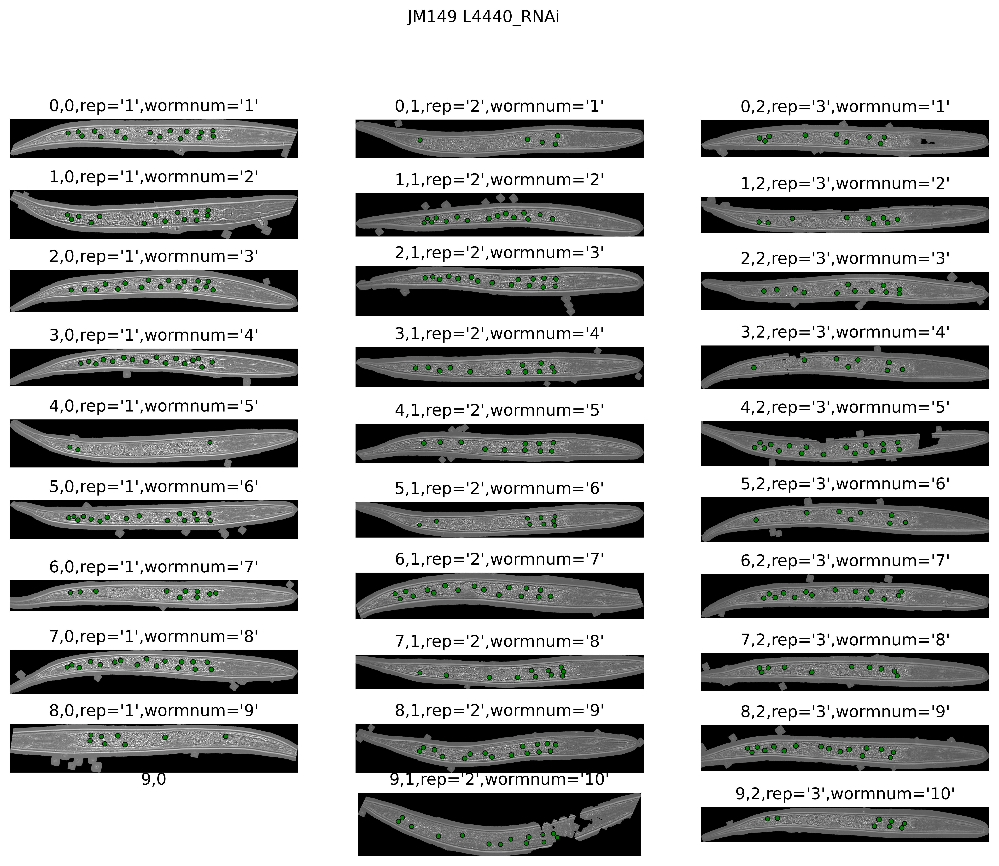

In [60]:
to_plot_rep_1 = []
to_plot_rep_2 = []
to_plot_rep_3 = []

for k,v in JM149_L4440.items():
    genotype, rep, stage, RNAi, worm = k
    if rep == "1":  to_plot_rep_1.append((k,v))
    if rep == "2":  to_plot_rep_2.append((k,v))
    if rep == "3":  to_plot_rep_3.append((k,v))

maxplotlen = 0
for to_plot in to_plot_rep_1, to_plot_rep_2, to_plot_rep_3:
    maxplotlen = max(maxplotlen, len(to_plot))
    try:
        to_plot.sort(key=lambda k: int(k[0][4]))
    except:
        to_plot.sort(key=lambda k: k[0][4])

fig, ax = plt.subplots(maxplotlen,3,dpi = 600, figsize=(13,10))
#plt.subplots_adjust(left=.2, right=.5, top=.5, bottom=0)
genotype, rep, stage, RNAi, worm = to_plot_rep_1[0][0]
fig.suptitle(f"{genotype} {RNAi}")
brightfield_plot_styles={'s': 1.5, 'alpha':1, 'linewidths':.5, 'facecolors': 'g', 'edgecolors': 'black' }
gfp_plot_styles={'s': 1.5, 'alpha':.5, 'linewidths':.5, 'facecolors': 'none', 'edgecolors': 'r' }
color_map = 'Greys_r'
from itertools import zip_longest

skip = []

for i,wormset in enumerate(zip_longest(to_plot_rep_1, to_plot_rep_2, to_plot_rep_3)):
    for j,worm in enumerate(wormset):
        ax[i,j].axis('off') 
        ax[i,j].grid(False)
        
        if worm is None: 
            ax[i,j].set(title=f"{i},{j}")
            continue
         
        k,v = worm
        genotype, rep, stage, RNAi, wormnum = k 
        
        ax[i,j].set(title=f"{i},{j},{rep=},{wormnum=}")
        if (j,i) in skip: continue
            

        df_in_mask_rotated = v['dataframe'] 
        rotated_cropped_segmented_image = v['rotated_cropped_segmented_image'] 
        rotated_cropped_masked_GFP = v['rotated_cropped_masked_GFP']

        annotate_spots(df_in_mask_rotated, rotated_cropped_segmented_image, ax=ax[i,j], plot_styles=brightfield_plot_styles)
        #annotate_spots(df_in_mask_rotated, rotated_cropped_masked_GFP, ax=ax[i,j], plot_styles=gfp_plot_styles)

plt.show()

## Plot JM149 ELT-2 RNAi

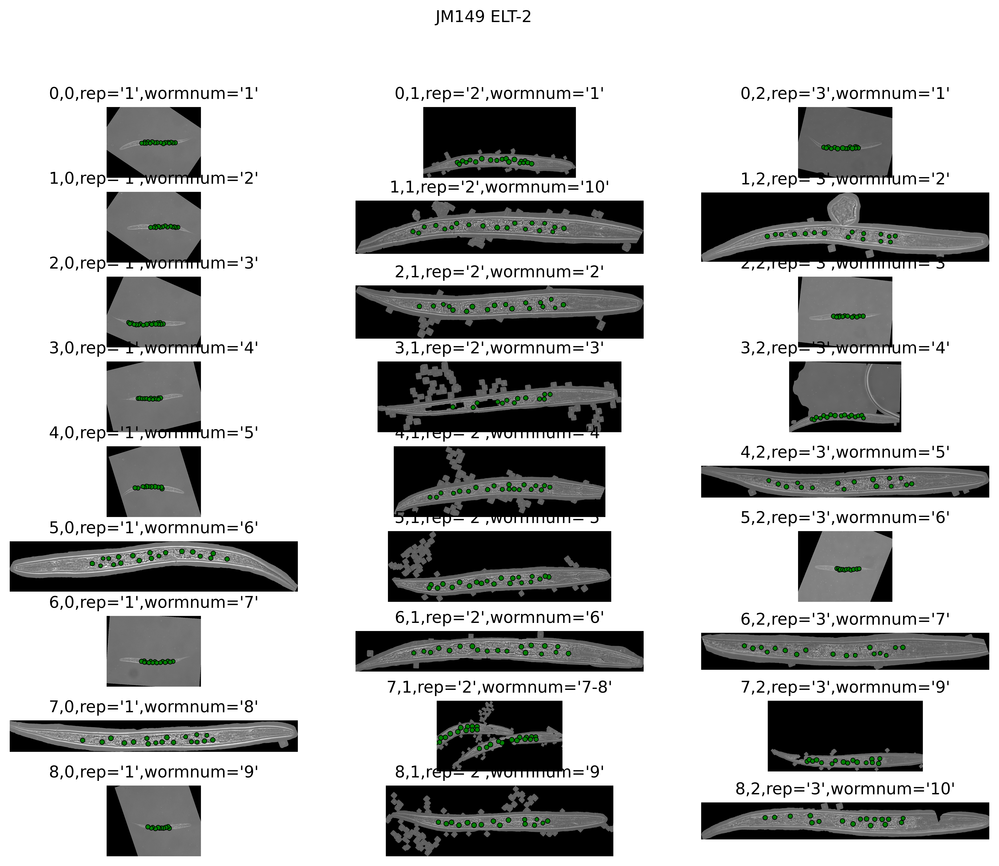

In [61]:
to_plot_rep_1 = []
to_plot_rep_2 = []
to_plot_rep_3 = []

for k,v in JM149_ELT2.items():
    genotype, rep, stage, RNAi, worm = k
    if rep == "1":  to_plot_rep_1.append((k,v))
    if rep == "2":  to_plot_rep_2.append((k,v))
    if rep == "3":  to_plot_rep_3.append((k,v))

maxplotlen = 0
for to_plot in to_plot_rep_1, to_plot_rep_2, to_plot_rep_3:
    maxplotlen = max(maxplotlen, len(to_plot))
    try:
        to_plot.sort(key=lambda k: int(k[0][4]))
    except:
        to_plot.sort(key=lambda k: k[0][4])

fig, ax = plt.subplots(maxplotlen,3,dpi = 600, figsize=(13,10))
#plt.subplots_adjust(left=.2, right=.5, top=.5, bottom=0)
genotype, rep, stage, RNAi, worm = to_plot_rep_1[0][0]
fig.suptitle(f"{genotype} {RNAi}")
brightfield_plot_styles={'s': 1.5, 'alpha':1, 'linewidths':.5, 'facecolors': 'g', 'edgecolors': 'black' }
gfp_plot_styles={'s': 1.5, 'alpha':.5, 'linewidths':.5, 'facecolors': 'none', 'edgecolors': 'r' }
color_map = 'Greys_r'
from itertools import zip_longest

skip = []

for i,wormset in enumerate(zip_longest(to_plot_rep_1, to_plot_rep_2, to_plot_rep_3)):
    for j,worm in enumerate(wormset):
        ax[i,j].axis('off') 
        ax[i,j].grid(False)
        
        if worm is None: 
            ax[i,j].set(title=f"{i},{j}")
            continue
         
        k,v = worm
        genotype, rep, stage, RNAi, wormnum = k 
        
        ax[i,j].set(title=f"{i},{j},{rep=},{wormnum=}")
        if (j,i) in skip: continue
            

        df_in_mask_rotated = v['dataframe'] 
        rotated_cropped_segmented_image = v['rotated_cropped_segmented_image'] 
        rotated_cropped_masked_GFP = v['rotated_cropped_masked_GFP']

        annotate_spots(df_in_mask_rotated, rotated_cropped_segmented_image, ax=ax[i,j], plot_styles=brightfield_plot_styles)
        #annotate_spots(df_in_mask_rotated, rotated_cropped_masked_GFP, ax=ax[i,j], plot_styles=gfp_plot_styles)

plt.show()